In [1]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib import font_manager
import os
import numpy as np
import random
import torchvision.datasets as dset

from sparc.feature_extract.extract_open_images import OpenImagesDataset
from sparc.feature_extract.extract_coco import CocoImagesDataset 
from sparc.post_analysis import HDF5AnalysisResultsDataset

In [2]:
def create_complete_figure(dim_idx, scenarios_list, dataset, num_images=10, img_size=140, random_sample=False, center_crop=False):
    modalities = ['dino', 'clip_img', 'clip_txt']
    modality_labels = ['Stream A (DINO)', 'Stream B (CLIP-img)', 'Stream C (CLIP-txt)']
    scenario_labels = [
        'Local TopK, λ=0',
        'Local TopK, λ=1',
        'Global TopK, λ=0',
        'Global TopK, λ=1'
    ]
    
    def center_crop_image(img, target_size):
        """
        Center crop the image to a square and resize to target_size.
        
        Args:
            img: PIL Image object
            target_size: Target size for the final image (int)
        
        Returns:
            PIL Image object that has been center cropped and resized
        """
        if not hasattr(img, 'size'):
            return img
            
        width, height = img.size
        
        # Calculate the size of the square crop (minimum dimension)
        crop_size = min(width, height)
        
        # Calculate crop coordinates to center the crop
        left = (width - crop_size) // 2
        top = (height - crop_size) // 2
        right = left + crop_size
        bottom = top + crop_size
        
        # Crop to square
        img_cropped = img.crop((left, top, right, bottom))
        
        # Resize to target size
        img_resized = img_cropped.resize((target_size, target_size))
        
        return img_resized
    
    # Create compact 2x2 figure with minimal spacing between blocks
    base_width = 27
    scaled_width = base_width * (num_images / 10)
    
    fig = plt.figure(figsize=(scaled_width, 9), dpi=300)
    
    # Add borders only on top and bottom (not sides)
    from matplotlib.lines import Line2D
    
    # Top border
    top_line = Line2D([0.085, 0.9], [0.9, 0.9], transform=fig.transFigure, 
                      color='gray', linewidth=1.5, alpha=0.8)
    fig.add_artist(top_line)
    
    # Bottom border  
    bottom_line = Line2D([0.085, 0.9], [0.1, 0.1], transform=fig.transFigure, 
                         color='gray', linewidth=1.5, alpha=0.8)
    fig.add_artist(bottom_line)
    
    fig.text(0.085, 0.88, f"Latent\nDim: {dim_idx}", fontsize=12, fontweight='bold', 
         fontname='monospace', 
         transform=fig.transFigure, verticalalignment='top',
         bbox=dict(boxstyle="round,pad=0.3", facecolor='lightcoral', alpha=0.7, edgecolor='navy'))
    main_grid = gridspec.GridSpec(2, 2, wspace=0.01, hspace=0.0) 
    
    # List to store captions for each scenario
    all_scenario_captions = []
    
    # Process each scenario in 2x2 grid layout
    for scenario_idx, analysis_results in enumerate(scenarios_list):
        # Determine row and column for 2x2 grid
        row, col = divmod(scenario_idx, 2)
        
        # Check if activations are non-zero (assertion only)
        for mod in modalities:
            if mod in analysis_results.streams:
                top_acts = analysis_results.get_top_activations_for_latent(mod, dim_idx)[:num_images]
                for act, _ in top_acts:
                    if act == 0:
                        return []
                        
        # Create subplot for this scenario - 3 rows (DINO, CLIP-img, CLIP-txt images)
        scenario_grid = gridspec.GridSpecFromSubplotSpec(3, 1, 
                                                      subplot_spec=main_grid[row, col],
                                                      height_ratios=[1, 1, 1], 
                                                      hspace=-0.18)
        
        # Add scenario label
        scenario_ax = fig.add_subplot(main_grid[row, col])
        scenario_ax.text(0.0, 0.98, f"{scenario_labels[scenario_idx]}", 
                       fontsize=10, fontweight='normal')
        scenario_ax.axis('off')
        
        # Process all three modalities for images
        for mod_idx, (mod, mod_label) in enumerate(zip(modalities, modality_labels)):
            # Get activating images based on random_sample parameter
            if random_sample:
                # Get top 50 activations first
                top_50_acts = analysis_results.get_top_activations_for_latent(mod, dim_idx)[:50]
                # Randomly sample num_images from these 50
                if len(top_50_acts) > num_images:
                    top_acts = random.sample(top_50_acts, num_images)
                else:
                    top_acts = top_50_acts[:num_images]  # In case there are fewer than num_images
            else:
                # Just get the top num_images as before
                top_acts = analysis_results.get_top_activations_for_latent(mod, dim_idx)[:num_images]
                
            # Create modality row
            ax = fig.add_subplot(scenario_grid[mod_idx])
            
            # Only show modality labels for left column (col=0)
            if col == 0:
                ax.text(-0.005, 0.5, mod_label, 
                      transform=ax.transAxes, 
                      fontsize=8, 
                      verticalalignment='center',
                      horizontalalignment='right')
            
            ax.axis('off')
            
            # Create thumbnail grid
            thumb_grid = gridspec.GridSpecFromSubplotSpec(1, num_images, 
                                                       subplot_spec=scenario_grid[mod_idx],
                                                       wspace=0.01)
            
            # Add thumbnails 
            for col_idx in range(num_images):
                thumb_ax = fig.add_subplot(thumb_grid[col_idx])
                
                if col_idx < len(top_acts):
                    # We have an actual activation
                    activation, img_idx = top_acts[col_idx]
                    img_idx = int(img_idx)
                    
                    try:
                        # Get image from OpenImagesDataset
                        img = dataset[img_idx]['image']
                        
                        # Process image based on center_crop parameter
                        if center_crop:
                            # Center crop to square and resize
                            img = center_crop_image(img, img_size)
                        else:
                            # Original behavior: just resize if possible
                            if hasattr(img, 'resize'):
                                img = img.resize((img_size, img_size))
                            
                        thumb_ax.imshow(img)
                    except (KeyError, Exception) as e:
                        # Handle missing or problematic images
                        thumb_ax.text(0.5, 0.5, f"Img {img_idx}\nN/A", 
                                   ha='center', va='center', fontsize=8)
                else:
                    # Not enough activations to fill this slot
                    # Create a placeholder with very light gray background
                    placeholder = np.ones((img_size, img_size, 3)) * 0.95  # Very light gray
                    thumb_ax.imshow(placeholder, cmap='gray')
                    thumb_ax.text(0.5, 0.5, 'N/A', 
                               ha='center', va='center', fontsize=10, 
                               color='gray', fontweight='normal',
                               transform=thumb_ax.transAxes)
                
                # No activation values displayed
                thumb_ax.axis('off')
                thumb_ax.set_xticks([])
                thumb_ax.set_yticks([])
        
        # Collect captions for the current scenario
        mod = 'clip_txt'
        top_acts = analysis_results.get_top_activations_for_latent(mod, dim_idx)[:num_images]
        
        scenario_captions = []
        for activation, img_idx in top_acts:
            img_idx = int(img_idx)
            
            try:
                # Get caption from OpenImagesDataset
                if len(dataset[img_idx]) > 1 and 'captions' in dataset[img_idx]:
                    caption = dataset[img_idx]['captions']
                    # If captions is a list, take the first one
                    if isinstance(caption, list) and len(caption) > 0:
                        caption = caption[0]
                else:
                    caption = "No caption available"
            except (KeyError, Exception):
                caption = "No caption available"
            
            scenario_captions.append(caption)
        
        all_scenario_captions.append(scenario_captions)
    
    return fig, all_scenario_captions

# Open Images

In [3]:
open_imgs_dir = '/home/ubuntu/Projects/OpenImages/'
dataset = OpenImagesDataset(open_imgs_dir, 'test')

analysis_results_global_cross = HDF5AnalysisResultsDataset('../../final_results/msae_open_global_with_cross/analysis_cache_val.h5', 256)
analysis_results_global_no_cross = HDF5AnalysisResultsDataset('../../final_results/msae_open_global_no_cross/analysis_cache_val.h5', 256)
analysis_results_local_cross = HDF5AnalysisResultsDataset('../../final_results/msae_open_local_with_cross/analysis_cache_val.h5', 256)
analysis_results_local_no_cross = HDF5AnalysisResultsDataset('../../final_results/msae_open_local_no_cross/analysis_cache_val.h5', 256)


Loading caption data from /home/ubuntu/Projects/OpenImages/captions/test/simplified_open_images_test_localized_narratives.json...
Loading label data...
Total number of classes: 601
Loading annotations from /home/ubuntu/Projects/OpenImages/labels/test-annotations-human-imagelabels-boxable.csv...
Loaded labels for 112194 images


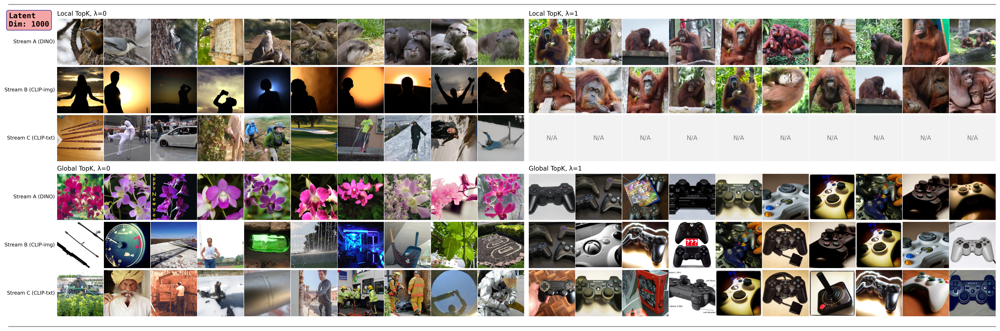

In [4]:
scenarios_list = [analysis_results_local_no_cross, analysis_results_local_cross, 
                  analysis_results_global_no_cross, analysis_results_global_cross]


# Change this to plot different dimensions
dim_idx = 1000
fig, captions = create_complete_figure(
    dim_idx=dim_idx,  
    scenarios_list=scenarios_list,
    dataset=dataset,
    num_images=10,
    random_sample=False,
    center_crop=True
)

In [5]:
# Print the captions for each scenario
for i, scenario_captions in enumerate(captions):
    print(f"Scenario {i+1} captions:")
    for j, caption in enumerate(scenario_captions):
        print(f"  {j+1}. {caption}")
    print()

Scenario 1 captions:
  1. In this picture we can see six walking sticks placed on the wooden table. Behind there is a book and black computer mouse.
  2. There is one person wearing a white color dress and holding walking sticks in the middle of this image. We can see a group of people and buildings in the background. There are vehicles and a board present on the right side of this image.
  3. In this image, there are cars on the floor and I can see groups of people standing. Among them one person is holding a walking stick and another person is holding a crutch. In the background, I can see a wall, a tent, banners with text and few other objects.
  4. This image is taken outdoors. At the bottom of the image there is a ground. On the right side of the image a man is standing on the ground and he is holding a walking stick in his hand and there is an object on the ground. In the background there are many plants in the pots. There are a few trees with leaves, stems and branches. In the m

# COCO 

In [6]:
coco_root = '../../dataset/COCO/'
coco_caps = dset.CocoCaptions(root=f'{coco_root}/val2017/',
                              annFile=f'{coco_root}/annotations/captions_val2017.json')

dataset = CocoImagesDataset(coco_caps)

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


In [7]:
analysis_results_global_cross = HDF5AnalysisResultsDataset('../../final_results/msae_coco_global_with_cross/analysis_cache_val.h5', 256)
analysis_results_global_no_cross = HDF5AnalysisResultsDataset('../../final_results/msae_coco_global_no_cross/analysis_cache_val.h5', 256)
analysis_results_local_cross = HDF5AnalysisResultsDataset('../../final_results/msae_coco_local_with_cross/analysis_cache_val.h5', 256)
analysis_results_local_no_cross = HDF5AnalysisResultsDataset('../../final_results/msae_coco_local_no_cross/analysis_cache_val.h5', 256)


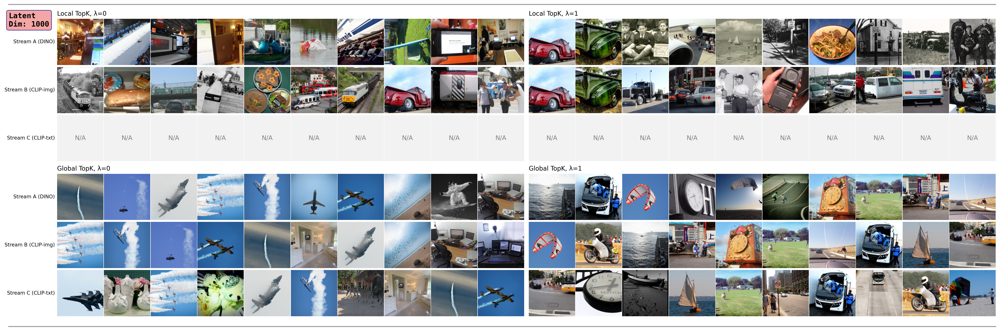

In [8]:
scenarios_list = [analysis_results_local_no_cross, analysis_results_local_cross, 
                  analysis_results_global_no_cross, analysis_results_global_cross]


# Change this to plot different dimensions
dim_idx = 1000
fig, captions = create_complete_figure(
    dim_idx=dim_idx,  
    scenarios_list=scenarios_list,
    dataset=dataset,
    num_images=10,
    random_sample=False,
    center_crop=True
)

In [9]:
# Print the captions for each scenario
for i, scenario_captions in enumerate(captions):
    print(f"Scenario {i+1} captions:")
    for j, caption in enumerate(scenario_captions):
        print(f"  {j+1}. {caption}")
    print()

Scenario 1 captions:

Scenario 2 captions:

Scenario 3 captions:
  1. A group of airplanes in the sky in formation.  The jets are flying through the air in unison. A row of four trick Navy Planes flying in sequence. The planes are all flying in the same direction. a formation of fighter jets flying by in the air
  2. Four vases with purple flower in it. There are two different shapes and sizes. Two different shaped white vases on a rack. There are four vases that have butterfly sculptures on them. A group of four matching vases are adorned with glass butterflies. Four different sized vases decorated with various sized butterflys.
  3. A formation of airplanes flying through a  blue sky. several jet planes flying in unison in a v formation  Several jets that are flying in the air performing tricks. Seven jets fly in formation leaving trails of smoke behind them. A sky view of several planes flying in formation in the sky.
  4. A group of white teddy bears on a white table. four small te